## This code is to assist with rescaling and registration of images between 60x and 20x.

In [1]:
# Basic utilities
import gc
import time
start_time = time.time()
import warnings
warnings.filterwarnings('ignore')
from pystackreg import StackReg
from skimage import io
from skimage.filters import threshold_li
from skimage.filters import threshold_local
from skimage.morphology import disk, ball
from skimage.color import rgb2gray
from skimage.filters.rank import mean_bilateral
from skimage.morphology import disk
from matplotlib.backends.backend_pdf import PdfPages
from skimage.transform import warp
from skimage.registration import optical_flow_tvl1
from skimage.filters import threshold_otsu, rank
import pickle as pkl
import cv2
import re
import sys
import glob
from imaris_ims_file_reader.ims import ims
import javabridge
import bioformats
# Data wrangling packages
import numpy as np
from scipy import stats
import skimage
import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (20,20)
import os, psutil
process = psutil.Process(os.getpid())

In [2]:
# check if config exists
try:
    config
except NameError:
    config_exists = False
else:
    config_exists = True
# make config if it does not exist already (e.g. passed in by papermill) for manual running
if not(config_exists):
    # set up some config for the experiment run
    config = {
        "data_url" : "8",
    }
print(config)

{'data_url': '8'}


In [3]:
# Use this function to threshold images
def thresh(imgstk):
    th = threshold_li(imgstk)
    imgstk = imgstk>= th
    return imgstk
# This function is used for removing background post stitching Max-projection
def background_correction(max_img):
    max_img = max_img[~np.all(max_img == 0, axis=1)]
    max_img = max_img[:,~np.all(max_img == 0, axis=0)]
    return max_img
#Dumping images to pickle file
def picklewriter(imglist, filename):
    fname = open(filename,'wb')
    for i in range(0,len(imglist)):
        pkl.dump(imglist[i], fname)
    fname.close()
# For 2D registration
def max_proj_transform(rf_img, cycle, v, u):
    #max_reg = []
    #i = 0
    #for cycle in imgs:
    chn = []
    for ch in range(0,cycle.shape[0]):
        print("Registering Cycle {}, Channel {}".format(i + 1, ch))
        reg = register_oflow(v,u, rf_img[:y,:x], cycle[ch,:y,:x])
        chn.append(reg)
    #max_reg.append(np.asarray(chn))
       # i = i+1
    return np.asarray(chn)
def visualizer(reg_stack):
    viewer = napari.Viewer(ndisplay=3)
    for v in range(0,len(reg_stack)):
        viewer.add_image(reg_stack[v], rgb=False, name='cyc'+str(v),blending='additive')
def shift_image(image, w, h):
    height, width = image.shape[:2]
    T = np.float32([[1, 0, w], [0, 1, h]])
    img_translation = cv2.warpAffine(image, T, (width, height))
    return img_translation
def oflow(image0, image1):
    # --- Convert the images to gray level: color is not supported.
    image0 = rgb2gray(image0)
    image1 = rgb2gray(image1)
    # --- Compute the optical flow with Iterative Lucas Kanade
    #v, u = optical_flow_ilk(image0, image1, radius=20)
    # --- Compute the optical flow with TVL1
    v, u = optical_flow_tvl1(image0, image1)
    return v, u
def register_oflow(v,u,image0, image1):
    image0 = rgb2gray(image0)
    image1 = rgb2gray(image1)
    # --- Use the estimated optical flow for registration
    nr, nc = image0.shape
    
    row_coords, col_coords = np.meshgrid(np.arange(nr), np.arange(nc),
                                         indexing='ij')
    image1_warp = warp(image1, np.array([row_coords + v, col_coords + u]),
                       mode='nearest')
    return image1_warp
def imagevis(image0,thresh_proj,reg, pp):
    nr, nc = image0.shape
    #pp = PdfPages(opdir+runName+'-registration.pdf')
    f, axarr = plt.subplots(1, 3)
    #for c in range(0,len(thresh_proj)):
    image1 = thresh_proj[:nr,:nc]
    image1_warp = thresh(reg[-1,:nr,:nc])
    # build an RGB image with the unregistered sequence
    seq_im = np.zeros((nr, nc, 3))
    seq_im[..., 0] = image1
    seq_im[..., 1] = image0
    seq_im[..., 2] = image0
        
    # build an RGB image with the registered sequence
    reg_im = np.zeros((nr, nc, 3))
    reg_im[..., 0] = image1_warp
    reg_im[..., 1] = image0
    reg_im[..., 2] = image0
        
    # build an RGB image with the registered sequence
    target_im = np.zeros((nr, nc, 3))
    target_im[..., 0] = image0
    target_im[..., 1] = image0
    target_im[..., 2] = image0
        
    # --- Show the result
    axarr[0].imshow(seq_im)
    axarr[0].set_title("Unregistered sequence")
    axarr[0].set_axis_off()
        
    axarr[1].imshow(reg_im)
    axarr[1].set_title("Registered sequence")
    axarr[1].set_axis_off()
        
    axarr[2].imshow(target_im)
    axarr[2].set_title("Target")
    axarr[2].set_axis_off()
        
    f.tight_layout()
    f.savefig(pp, format='pdf')
    #pp.close()

In [4]:
### VARIABLE DEFINITION ###
runName = 'P1_4'
maxpro = True # Set false if 3D registration required
interactive = False #If true will show napari visualizations
opdir = '/mnt/disks/external/jg4159/20231006_DDR364/' # Path to output

In [5]:
pwd = opdir + "20231006_jg4159_DDR364_Ab[0-3]_" + runName + "*FusionStitcher.ims"
#Loading ims files for different cycles
lof = glob.glob(pwd)
lof.sort()
for i in range(len(lof)):
    print(lof[i])

/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab0_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab1_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab2_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab3_P1_4_FusionStitcher.ims


In [6]:
pwd = opdir + "20231006_jg4159_DDR364_CM[1-8]_" + runName + "*FusionStitcher.ims"
lof2 = glob.glob(pwd)
#lof.append(lof2)
lof2.sort()
for i in range(len(lof2)):
    print(lof2[i])

/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM1_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM2_P1_4-TV_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM3_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM4_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM5_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM6_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM7_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM8_P1_4_FusionStitcher.ims


In [7]:
pwd = opdir + "20231006_jg4159_DDR364_RM[1-8]_" + runName + "*FusionStitcher.ims"
lof3 = glob.glob(pwd)
#lof.append(lof2)
lof3.sort()
for i in range(len(lof3)):
    print(lof3[i])

/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM1_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM2_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM3_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM4_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM5_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM6_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM7_P1_4_FusionStitcher.ims
/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_RM8_P1_4_FusionStitcher.ims


In [8]:
# Define refcyle
refcycle = ims(lof[0], ResolutionLevelLock=3)
s = np.max(np.asarray(refcycle[0,4,:,:,:]),axis=0)
print(s.shape)

Opening readonly file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab0_P1_4_FusionStitcher.ims 

(6938, 6938)


In [9]:
thresh_proj = []
thresh_proj.append(thresh(s))

In [10]:
lof = lof + lof2 + lof3
lof

['/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab0_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab1_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab2_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab3_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM1_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM2_P1_4-TV_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM3_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM4_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM5_P1_4_FusionStitcher.ims',
 '/mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_CM6_P1_4_FusionStitcher.ims',
 '/mnt/disks/exte

Opening readonly file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab1_P1_4_FusionStitcher.ims 

(4, 6973, 6966)
Closing file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab1_P1_4_FusionStitcher.ims 

(6938, 6938)
(6938, 6938)
(6938, 6938)
(6938, 6938)
Registering Cycle 1, Channel 0
Registering Cycle 1, Channel 1
Registering Cycle 1, Channel 2
Registering Cycle 1, Channel 3
Round1 score: 0.8289174688901035



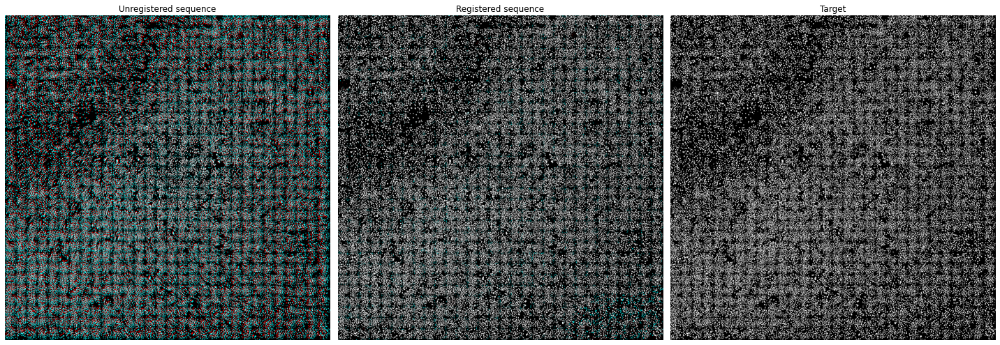

In [11]:
# Register the remaining cycles one by one
file2 = open(opdir+"Registration_" + runName + '_correlation_score_report.txt', "w")
a=0
reg_stack = []
pp = PdfPages(opdir+runName+'-registration.pdf')
for i in range(1):
    cyc1=ims(lof[1], ResolutionLevelLock=3)
    t = np.max(np.asarray(cyc1[0,:,:,:,:]),axis=1)#np.max(np.asarray(cyc[i][0,:,:,ylow:yhigh,xlow:xhigh]),axis=1)
    print(t.shape)
    del cyc1
    gc.collect()
    # resize all cahnnels in cyc1
    img = []
    for ch in range(t.shape[0]):
        res = cv2.resize(t[ch,:,:], dsize=(s.shape[1], s.shape[0]), interpolation=cv2.INTER_CUBIC)#cv2.resize(cyclist[i][ch,:,:], dsize=(s.shape[0], s.shape[1]), interpolation=cv2.INTER_CUBIC)
        print(res.shape)
        img.append(res)
    del t
    gc.collect()
    img = np.asarray(img)
    thresh1 = thresh(img[-1,:,:])
    # Register the max projection of the nuclei using oflow
    y = thresh_proj[0].shape[0]
    x = thresh_proj[0].shape[1]
    v, u = oflow(thresh_proj[0][:y,:x], thresh1[:y,:x])
    max_img = max_proj_transform(thresh_proj[0], img, v, u)
    reg_stack.append(max_img)
    imagevis(thresh_proj[0],thresh1,(max_img), pp)
    del img
    gc.collect()
    img = thresh(max_img[-1])
    cm = np.corrcoef(s.flat, img.flat)
    file2.write(f"Round{a+1} score: {cm[0,1]}\n")
    print(f"Round{a+1} score: {cm[0,1]}\n")
    a = a+1
    del img
    del max_img
    del thresh1
    gc.collect()

Opening readonly file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab2_P1_4_FusionStitcher.ims 

(5, 9332, 9327)
Closing file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab2_P1_4_FusionStitcher.ims 

(6938, 6938)
(6938, 6938)
(6938, 6938)
(6938, 6938)
(6938, 6938)
Registering Cycle 3, Channel 0
Registering Cycle 3, Channel 1
Registering Cycle 3, Channel 2
Registering Cycle 3, Channel 3
Registering Cycle 3, Channel 4
Round2 score: 0.7877260845600573

Opening readonly file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab3_P1_4_FusionStitcher.ims 

(4, 9323, 9339)
Closing file: /mnt/disks/external/jg4159/20231006_DDR364/20231006_jg4159_DDR364_Ab3_P1_4_FusionStitcher.ims 

(6938, 6938)
(6938, 6938)
(6938, 6938)
(6938, 6938)
Registering Cycle 4, Channel 0
Registering Cycle 4, Channel 1
Registering Cycle 4, Channel 2
Registering Cycle 4, Channel 3
Round3 score: 0.7888077672649105

Opening readonly file: /mnt/disks/external/jg4

MemoryError: Unable to allocate 14.9 GiB for an array with shape (1, 4, 23, 9325, 9337) and data type uint16

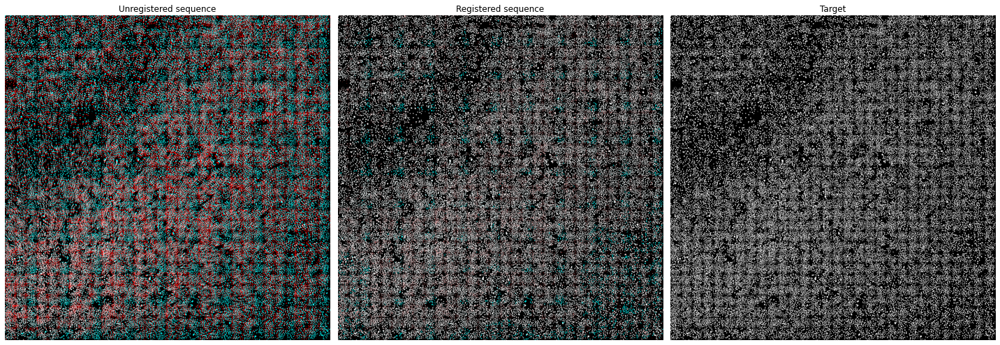

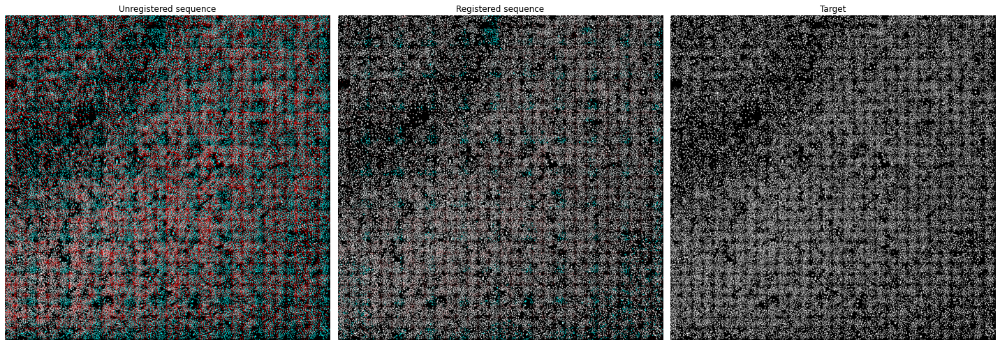

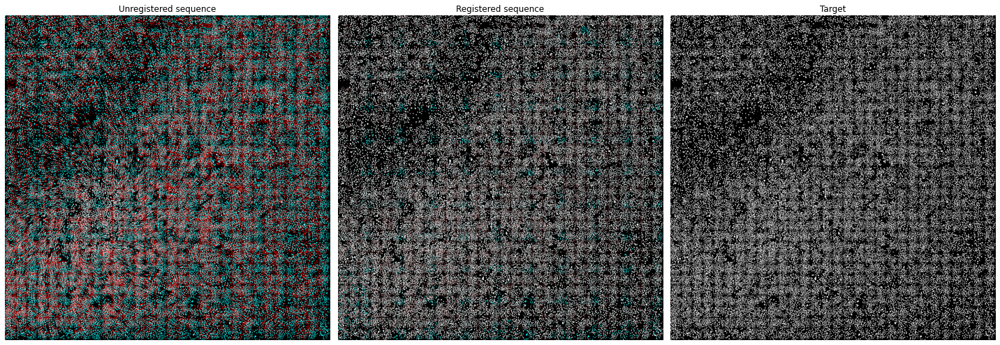

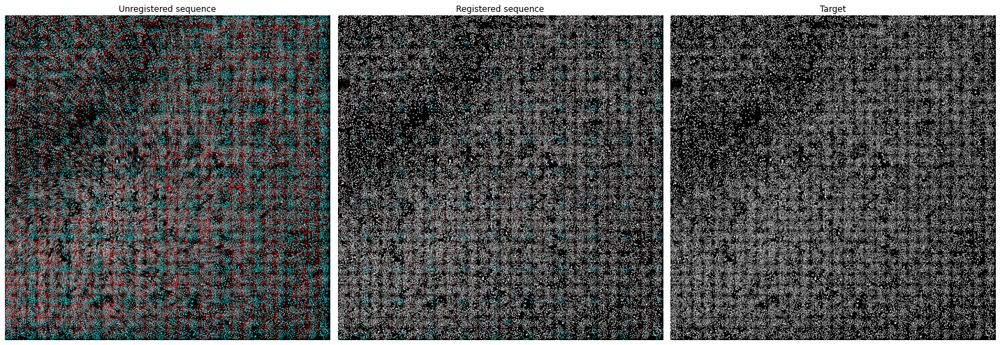

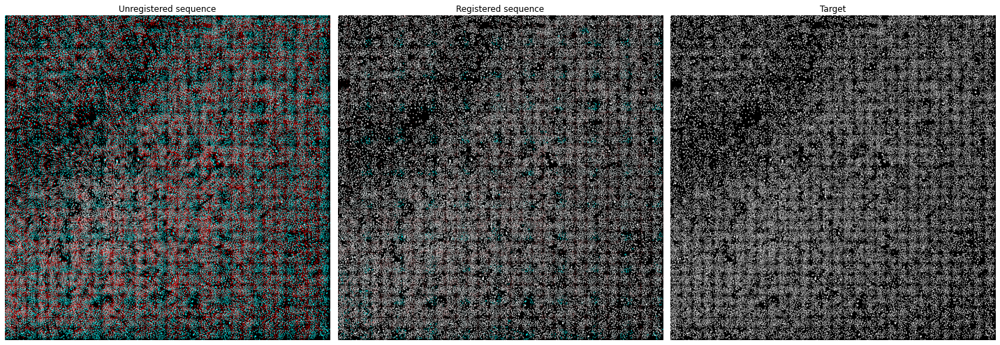

...

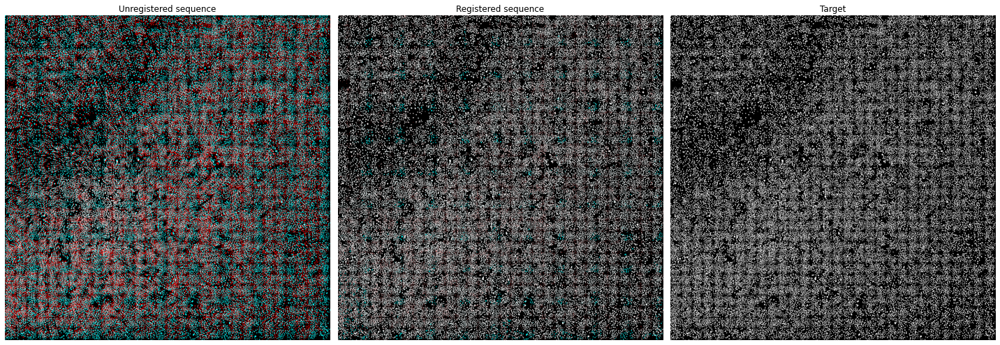

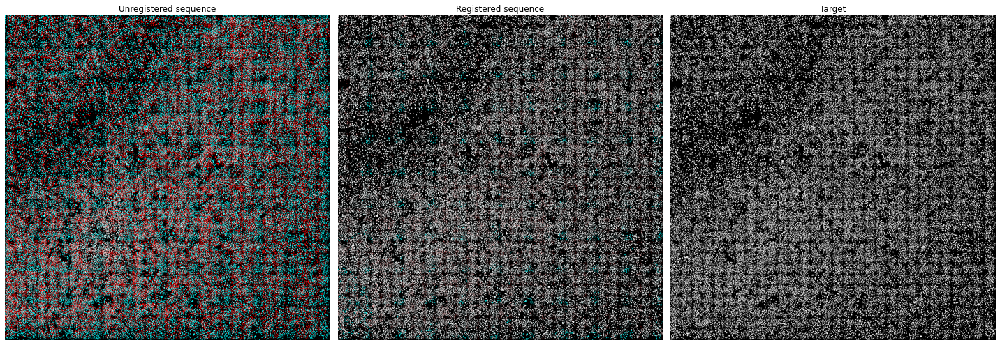

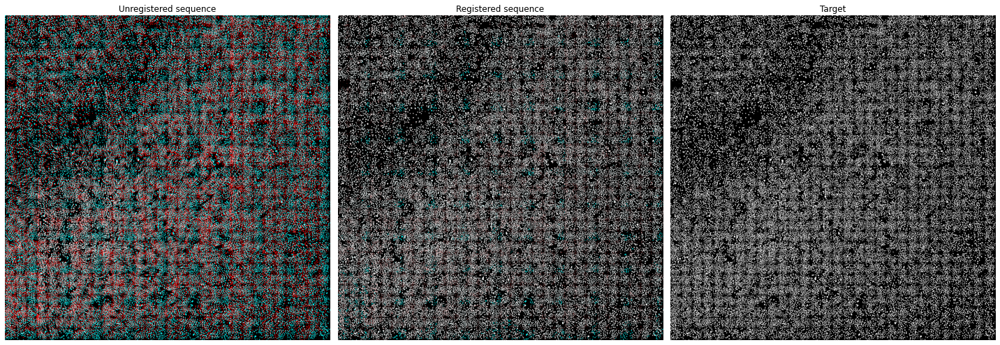

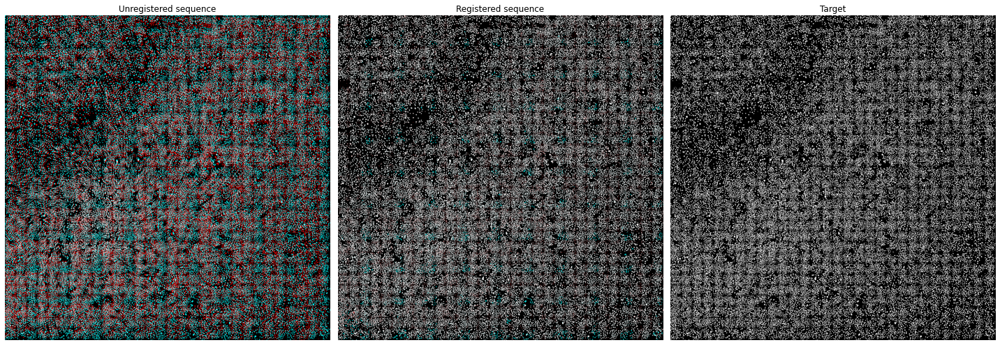

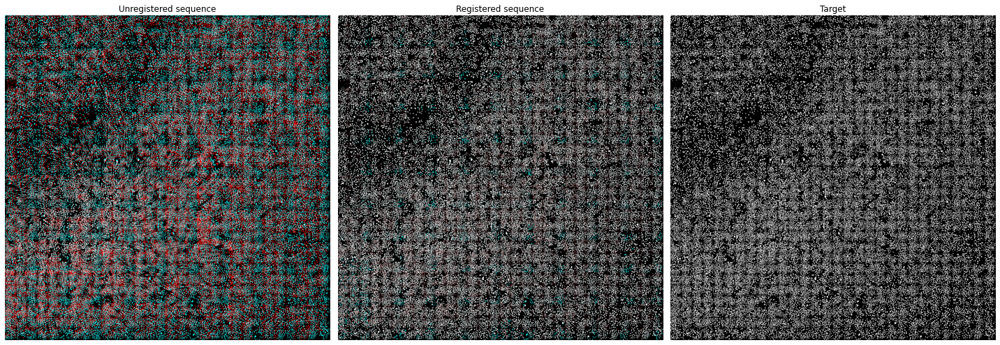

In [12]:
# Register the remaining cycles one by one
#file2 = open(opdir+"Registration_" + runName + '_correlation_score_report.txt', "w")
#a=0
#reg_stack = []
#pp = PdfPages(opdir+runName+'-registration.pdf')
for i in range(2,len(lof)):
    cyc1=ims(lof[i], ResolutionLevelLock=1)
    t = np.max(np.asarray(cyc1[0,:,:,:,:]),axis=1)#np.max(np.asarray(cyc[i][0,:,:,ylow:yhigh,xlow:xhigh]),axis=1)
    print(t.shape)
    del cyc1
    gc.collect()
    # resize all cahnnels in cyc1
    img = []
    for ch in range(t.shape[0]):
        res = cv2.resize(t[ch,:,:], dsize=(s.shape[1], s.shape[0]), interpolation=cv2.INTER_CUBIC)#cv2.resize(cyclist[i][ch,:,:], dsize=(s.shape[0], s.shape[1]), interpolation=cv2.INTER_CUBIC)
        print(res.shape)
        img.append(res)
    del t
    gc.collect()
    img = np.asarray(img)
    thresh1 = thresh(img[-1,:,:])
    # Register the max projection of the nuclei using oflow
    y = thresh_proj[0].shape[0]
    x = thresh_proj[0].shape[1]
    v, u = oflow(thresh_proj[0][:y,:x], thresh1[:y,:x])
    max_img = max_proj_transform(thresh_proj[0], img, v, u)
    reg_stack.append(max_img)
    imagevis(thresh_proj[0],thresh1,(max_img), pp)
    del img
    gc.collect()
    img = thresh(max_img[-1])
    cm = np.corrcoef(s.flat, img.flat)
    file2.write(f"Round{a+1} score: {cm[0,1]}\n")
    print(f"Round{a+1} score: {cm[0,1]}\n")
    a = a+1
    del img
    del max_img
    del thresh1
    gc.collect()

In [ ]:
reg_stack.insert(0, np.max(np.asarray(refcycle[0,:,:,:,:]),axis=1))

In [ ]:
print(len(reg_stack))

In [ ]:
filehandler = open(opdir+'RegisteredImages_Ab_' + runName + '.pkl', 'wb')
pkl.dump(reg_stack[:4], filehandler)
filehandler.close()
filehandler = open(opdir+'RegisteredImages_CM_' + runName + '.pkl', 'wb')
pkl.dump(reg_stack[4:12], filehandler)
filehandler.close()
filehandler = open(opdir+'RegisteredImages_RM_' + runName + '.pkl', 'wb')
pkl.dump(reg_stack[12:18], filehandler)
filehandler.close()

In [ ]:
file2.write("--- %s seconds ---" +str(time.time() - start_time)+"\n")
file2.write(str(process.memory_info().rss/10**9))
file2.close()

In [ ]:
pp.close()